In [1]:
from pathlib import Path
import json
import pandas as pd
import numpy as np
from IPython.display import display, HTML
from datetime import datetime
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from functools import reduce


In [2]:
def list_json_dir(folder):
    p = Path(folder)

    # list files in dir
    files = [f for f in p.iterdir() if f.suffix == '.json']
    return files

def read_json(f_path):
    with f_path.open('r') as fp:
        json_dict = json.load(fp)
        
        json_dict.update({'fname':f_path.name})
        
    return json_dict

In [3]:
def plot_instance_post(df, instance, col):
    
    if instance:
        df_inst_col = df[df['instance'] == instance][['#expl','config', col, 'totTime']]
    else:
        df_inst_col = df[['#expl','config', col, 'totTime']]

    df_inst_col['x'] = df_inst_col[col].apply(lambda x: [i for i in range(1, len(x) + 1)])
    df_inst_col = df_inst_col.sort_values(by=['#expl','totTime'], ascending=[False, True])

    plt.figure(figsize=(30,15))
    for i, row in df_inst_col.iterrows():
        print(row)
        plt.plot(row['x'], row[col], label=row['config'])
        
    # Plot formatting
    plt.legend(fontsize=20, loc='upper left')
    plt.xlim((0, 20))
    plt.ylim((0, 2000))
    plt.xlabel('Number of explanation steps', fontsize=20)
    plt.ylabel('Execution time (s) - timeout [7200s]', fontsize=20)
    plt.title("Title")
    
    plt.show()


In [4]:
import matplotlib.pyplot as plt

# Origin problem
def plot_instance_col(df, instance, col):
    if instance:
        df_inst_col = df[df['instance'] == instance][['#expl','config', col, 'totTime']]
    else:
        df_inst_col = df[['#expl','config', col, 'totTime']]
#     print(df_inst_col)
    df_inst_col['x'] = df_inst_col[col].apply(lambda x: [i for i in range(1, len(x) + 1)])
    df_inst_col = df_inst_col.sort_values(by=['#expl','totTime'], ascending=[False, True])

    plt.figure(figsize=(30,30))
    for i, row in df_inst_col.iterrows():
        plt.plot(row['x'], row[col], label=row['config'])
        
    # Plot formatting
    plt.legend(fontsize=20)
    # plt.xlim((0, 50))
    plt.xlabel('Number of explanation steps', fontsize=20)
    plt.ylabel('Execution time (s) - timeout [7200s]', fontsize=20)
#     plt.title(instance + " - " + col)
    plt.title("Title")
    plt.savefig('/home/crunchmonster/Desktop/figs/'+ datetime.now().strftime("%Y%m%d%H%M%S%f.jpg"), optimize=True, bbox_inches='tight')
    plt.show()


In [5]:
def jsonFilesToPandasDF(json_files):
    timeoutTime = 7200
    pd_dict = {
        # running parameters
        'timedout':[],
        'config':[],
        'cumul-ous': [],
        'cumul-sat':[],
        'cumul-post':[],
        'cumul-opt':[],
        'cumul-HS': [],
        'cumul-HS-all': [],
        'totTime': [],
        'timeToFirst': [],
        'First-Tot': [],
        'fname':[],
        'created':[],
        'maxsat_polarities':[]
    }

    config_mapping = {
            'preseeding': 'pre',
            'preseeding-grow': 'pre-grow',
            'sat-polarity':'satpol',
            'sat-polarity-initial': 'satpol-ini',
            'postpone_opt_incr':'incr',
            'postpone_opt_greedy':'greedy',
            'grow_subset_maximal':'subset-max',
            'grow_sat':'grow_sat',
            'grow_maxsat_full_unif':"MaxSat-A-unif",
            'grow_maxsat_full_pos':"MaxSat-A-pos",
            'grow_maxsat_full_inv': "MaxSat-A-inv",
            'grow_maxsat_initial_pos': "MaxSat-I0-pos", 
            'grow_maxsat_initial_inv':  "MaxSat-I0-inv", 
            'grow_maxsat_initial_unif': "MaxSat-I0-unif", 
            'grow_maxsat_actual_pos':  "MaxSat-Icur-pos",  
            'grow_maxsat_actual_unif': "MaxSat-Icur-unif", 
            'grow_maxsat_actual_inv': "MaxSat-Icur-inv",
            'maxsat_polarities': "maxsat_polarities"
    }
    

    for f_json in json_files:
        for k, v in f_json['config'].items():
            if k not in pd_dict:
                pd_dict[k] = []
            pd_dict[k].append(v)
        for k, v in f_json['results'].items():
            if k == 'timeout':
                pd_dict['timedout'].append(v)
                continue
            if k not in pd_dict:
                pd_dict[k] = []
            pd_dict[k].append(v)
        if 'maxsat_polarities' not in f_json['config']:
            pd_dict["maxsat_polarities"].append(False)
        pd_dict['fname'].append(f_json['fname'])
        
        pd_dict['created'].append(datetime.strptime(f_json['fname'].split('_')[1].replace('.json',''), '%Y%m%d%H%M%S%f'))

        add_configs = [f_json['config']['instance'] if f_json['config']['instance'] != 'origin-problem' else 'puzzle']

        for k,v in f_json['config'].items():
            if v == True and k in config_mapping:
                add_configs.append(config_mapping[k])

        if pd_dict['timedout']:
            pd_dict['totTime'].append(timeoutTime)
                
        pd_dict['config'].append('_'.join(add_configs))
        if 'OUS-time' in f_json['results']: 
            pd_dict['cumul-ous'].append( 
                ([
                    sum(f_json['results']['OUS-time'][:i+1]) 
                    for i in range(len(f_json['results']['OUS-time'])) ] + []) if not pd_dict['timedout'] else ([sum(f_json['results']['OUS-time'][:i+1]) for i in range(len(f_json['results']['OUS-time'])) ] + [timeoutTime])
            )
        if 'OUS-time' in f_json['results']: 
            pd_dict['timeToFirst'].append(f_json['results']['OUS-time'][1])
            pd_dict['First-Tot'].append(f"{round(f_json['results']['OUS-time'][1], 2)} - [{f_json['results']['#expl']}] {'' if pd_dict['timedout'] else pd_dict['totTime'][-1]}" )
        else:
            pd_dict['timeToFirst'].append('-')
            pd_dict['First-Tot'].append('-')
        if 'HS-opt-time' in f_json['results']: 
            pd_dict['cumul-opt'].append( [sum(f_json['results']['HS-opt-time'][:i+1]) for i in range(len(f_json['results']['HS-opt-time'])) ])
        else:
            pd_dict['cumul-opt'].append('-')
        if 'HS-postpone-time' in f_json['results']: 
            pd_dict['cumul-post'].append( [sum(f_json['results']['HS-postpone-time'][:i+1]) for i in range(len(f_json['results']['HS-postpone-time'])) ])
        else:
            pd_dict['cumul-post'].append('-')
        if 'SAT-time' in f_json['results']: 
            pd_dict['cumul-sat'].append( [sum(f_json['results']['SAT-time'][:i+1]) for i in range(len(f_json['results']['SAT-time'])) ])
        else:
            pd_dict['cumul-sat'].append('-')
        if 'HS' in f_json['results']: 
            pd_dict['cumul-HS'].append( [sum(f_json['results']['HS'][:i+1]) for i in range(len(f_json['results']['HS'])) ])
            pd_dict['cumul-HS-all'].append( [sum(f_json['results']['HS'][:i+1])+sum(f_json['results']['HS_incr'][:i+1])+sum(f_json['results']['HS_greedy'][:i+1]) for i in range(len(f_json['results']['HS'])) ])
        else:
            pd_dict['cumul-HS-all'].append('-')
            pd_dict['cumul-HS'].append('-')

    for k, v in pd_dict.items():
        print(k, len(v))
    return pd.DataFrame(pd_dict), pd_dict

# Experiment 1

In [6]:
# processing the results
folder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment1/2021011305'
files = list_json_dir(folder)
json_files = [read_json(f) for f in files]
dfjson, dfdict = jsonFilesToPandasDF(json_files)

#dfjson.view()
display(dfjson)
#display(dfjson[["preseeding", "preseeding-grow"]])
# display(dfjson)
# origin problem
# origin = dfjson[dfjson["instance"] == "origin-problem"]

timedout 86
config 86
cumul-ous 86
cumul-sat 86
cumul-post 86
cumul-opt 86
cumul-HS 86
cumul-HS-all 86
totTime 86
timeToFirst 86
First-Tot 86
fname 86
created 86
maxsat_polarities 86
preseeding 86
sat-polarity 86
sat-polarity-initial 86
postpone_opt 86
postpone_opt_incr 86
postpone_opt_greedy 86
grow 86
grow_sat 86
grow_subset_maximal 86
grow_maxsat 86
grow_maxsat_full_pos 86
grow_maxsat_full_inv 86
grow_maxsat_full_unif 86
grow_maxsat_initial_pos 86
grow_maxsat_initial_inv 86
grow_maxsat_initial_unif 86
grow_maxsat_actual_pos 86
grow_maxsat_actual_unif 86
grow_maxsat_actual_inv 86
timeout 86
instance 86
output 86
HS 86
HS_greedy 86
HS_incr 86
HS-opt-time 86
HS-postpone-time 86
SAT-time 86
grow-time 86
#expl 86
expl_seq 86
OUS-time 86


,timedout,config,cumul-ous,cumul-sat,cumul-post,cumul-opt,cumul-HS,cumul-HS-all,totTime,timeToFirst,...,HS,HS_greedy,HS_incr,HS-opt-time,HS-postpone-time,SAT-time,grow-time,#expl,expl_seq,OUS-time
0,True,p20_satpol_MaxSat-A-inv,"[0, 14.609150886535645, 24.608795166015625, 53...","[0, 0.20017409324645996, 0.27631330490112305, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 1.7190723419189453, 6.850437879562378, 25....","[0, 114, 157, 259, 504, 696, 940, 954, 1060, 1...","[0, 114, 157, 259, 504, 696, 940, 954, 1060, 1...",7200,14.609151,...,"[0, 114, 43, 102, 245, 192, 244, 14, 106, 115,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 1.7190723419189453, 5.131365537643433, 18....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0.20017409324645996, 0.07613921165466309, ...","[0, 12.576448917388916, 4.748327016830444, 10....",9,"[{'constraints': [1696], 'derived': [64]}, {'c...","[0, 14.609150886535645, 9.99964427947998, 29.0..."
1,True,p12_satpol_subset-max,"[0, 24.897790908813477, 27.593591690063477, 45...","[0, 1.099640130996704, 1.111900806427002, 1.20...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 23.254570960998535, 25.931615591049194, 43...","[0, 172, 176, 196, 197, 213, 252, 254, 260, 29...","[0, 172, 176, 196, 197, 213, 252, 254, 260, 29...",7200,24.897791,...,"[0, 172, 4, 20, 1, 16, 39, 2, 6, 39, 381, 61]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 23.254570960998535, 2.677044630050659, 17....","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 1.099640130996704, 0.012260675430297852, 0...","[0, 0.8833856582641602, 0.007180452346801758, ...",10,"[{'constraints': [1694], 'derived': [-15]}, {'...","[0, 24.897790908813477, 2.69580078125, 18.1146..."
2,True,p16_satpol_MaxSat-A-pos,"[0, 214.6375434398651, 1518.7239017486572, 216...","[0, 0.10255217552185059, 0.10520792007446289, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0.21004533767700195, 0.22899985313415527, ...","[0, 40, 42, 57, 58, 62, 72, 73, 103, 105]","[0, 40, 42, 57, 58, 62, 72, 73, 103, 105]",7200,214.637543,...,"[0, 40, 2, 15, 1, 4, 10, 1, 30, 2]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0.21004533767700195, 0.01895451545715332, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0.10255217552185059, 0.0026557445526123047...","[0, 214.27532839775085, 1304.0627324581146, 64...",8,"[{'constraints': [1696], 'derived': [25]}, {'c...","[0, 214.6375434398651, 1304.0863583087921, 648..."
3,True,p12_satpol_MaxSat-A-inv,"[0, 14.202023267745972, 33.25591540336609, 86....","[0, 0.19799327850341797, 0.34001588821411133, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 1.7165114879608154, 12.46753454208374, 47....","[0, 116, 197, 323, 555, 792, 826, 933, 1056, 1...","[0, 116, 197, 323, 555, 792, 826, 933, 1056, 1...",7200,14.202023,...,"[0, 116, 81, 126, 232, 237, 34, 107, 123, 246,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 1.7165114879608154, 10.751023054122925, 35...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]","[0, 0.19799327850341797, 0.14202260971069336, ...","[0, 12.171517610549927, 8.082395792007446, 17....",9,"[{'constraints': [1692], 'derived': [74]}, {'c...","[0, 14.202023267745972, 19.053892135620117, 53..."
4,True,pastaPuzzle_satpol_MaxSat-A-unif,"[0, 10.227003812789917, 598.5074059963226, 606...","[0, 0.11206364631652832, 0.9704933166503906, 0...","[0, 0, 0, 0, 0, 0]","[0, 0.7844698429107666, 366.1818573474884, 373...","[0, 88, 748, 754, 761, 1469]","[0, 88, 748, 754, 761, 1469]",7200,10.227004,...,"[0, 88, 660, 6, 7, 708]","[0, 0, 0, 0, 0, 0]","[0, 0, 0, 0, 0, 0]","[0, 0.7844698429107666, 365.39738750457764, 7....","[0, 0, 0, 0, 0, 0]","[0, 0.11206364631652832, 0.8584296703338623, 0...","[0, 9.272849321365356, 221.56568312644958, 0.3...",4,"[{'constraints': [906], 'derived': [-12]}, {'c...","[0, 10.227003812789917, 588.2804021835327, 7.7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,False,p18_satpol_subset-ma

In [16]:
instances = set(dfdict['instance'])

colRenaming = {
    'p20':6, 
    'p93':8, 
    'pastaPuzzle':'p', 
    'p16':2, 
    'p25':7, 
    'origin-problem':1, 
    'p18':4, 
    'p13':10, 
    'p12':3,
    'p19':5
}

dfTableExp1 = dfjson[[
    'instance',
     'timeToFirst', 
    'totTime',
    'First-Tot',
     'created', 
     'grow', 
     'grow_sat', 
     'grow_subset_maximal', 
     'grow_maxsat', 
     'grow_maxsat_full_pos', 
     'grow_maxsat_full_inv', 
     'grow_maxsat_full_unif',
     'timedout']]
# display(HTML(dfTableExp1.to_html()))

d = dfTableExp1.to_dict('list')
selectedCols = list(d.keys())
#print(selectedCols)
Timeout = 'T.O.'
dictExp1MaxSatPol = {
    k: [Timeout] * len(set(d['instance'])) for k in ['instance', 'no-grow', 'sat', 'subset', 'maxsat_pos', 'maxsat_inv', 'maxsat_unif']
}
dictExp1NoPol = {
    k: [Timeout] * len(set(d['instance'])) for k in ['instance', 'no-grow', 'sat', 'subset', 'maxsat_pos', 'maxsat_inv', 'maxsat_unif']
}
dictExp1MaxSatPol['instance'] = list(set(d['instance']))
dictExp1NoPol['instance'] = list(set(d['instance']))


for inst, firstTot, nogrow, sat, subset, maxsat_pos, maxsat_inv, maxsat_unif in zip(d['instance'], d['First-Tot'],d['grow'], d['grow_sat'], d['grow_subset_maximal'], d['grow_maxsat_full_pos'], d['grow_maxsat_full_inv'], d['grow_maxsat_full_unif']):
#     print(nogrow, sat, subset, maxsat_pos, maxsat_inv, maxsat_unif)
    pos = dictExp1NoPol['instance'].index(inst)
#     print(firstTot)
    if firstTot == '0 - [0] ':
        firstTot = Timeout
#     print(pos)
    if not nogrow:
        if dictExp1MaxSatPol['no-grow'][pos]!= Timeout:
            dictExp1NoPol['no-grow'][pos] = firstTot
        else:
            dictExp1MaxSatPol['no-grow'][pos] = firstTot
    elif sat:
        if dictExp1MaxSatPol['sat'][pos]!= Timeout:
            dictExp1NoPol['sat'][pos] = firstTot
        else:
            dictExp1MaxSatPol['sat'][pos] = firstTot
    elif subset:
        if dictExp1MaxSatPol['subset'][pos]!= Timeout:
            dictExp1NoPol['subset'][pos] = firstTot
        else:
            dictExp1MaxSatPol['subset'][pos] = firstTot
    elif maxsat_pos:
        if dictExp1MaxSatPol['maxsat_pos'][pos]!= Timeout:
            dictExp1NoPol['maxsat_pos'][pos] = firstTot
        else:
            dictExp1MaxSatPol['maxsat_pos'][pos] = firstTot
    elif maxsat_inv:
        if dictExp1MaxSatPol['maxsat_inv'][pos]!= Timeout:
            dictExp1NoPol['maxsat_inv'][pos] = firstTot
        else:
            dictExp1MaxSatPol['maxsat_inv'][pos] = firstTot
    elif maxsat_unif:
        if dictExp1MaxSatPol['maxsat_unif'][pos]!= Timeout:
            dictExp1NoPol['maxsat_unif'][pos] = firstTot
        else:
            dictExp1MaxSatPol['maxsat_unif'][pos] = firstTot
    else:
        print("!!!!!!")
dictExp1MaxSatPol['p'] = [colRenaming[l] for l in dictExp1MaxSatPol['instance'] ]
ignoreCols = ['instance']
selected_cols = [k for k in dictExp1MaxSatPol if k not in ignoreCols]



display(HTML("<H1>MaxSAT No polarities</H1>"))
pddictExp1MaxSatPol = pd.DataFrame.from_dict(dictExp1MaxSatPol)[['p', 'no-grow','sat', 'subset', 'maxsat_pos', 'maxsat_inv', 'maxsat_unif']]
display(HTML(pddictExp1MaxSatPol.to_html()))

tx = pddictExp1MaxSatPol.to_latex(
    bold_rows=True,
    index=False, 
    column_format='|r||c|c|c|c|c|',
    caption="Execution time generic grow version")
print(tx.replace('\\toprule', '\hline')
      .replace('\midrule', '\hline')
      .replace('\\bottomrule', '\hline')
      .replace('{table}', '{table*}')
     )

# display(HTML("<H1>No MaxSAT polarities</H1>"))
# pddictExp1NoPol = pd.DataFrame.from_dict(dictExp1NoPol)
# display(HTML(pddictExp1NoPol.to_html()))

,p,no-grow,sat,subset,maxsat_pos,maxsat_inv,maxsat_unif
0,5,0.16 - [1],0.16 - [3],0.16 - [5],0.16 - [2],0.16 - [3],0.16 - [3]
1,10,T.O.,15.21 - [8],25.93 - [8],690.74 - [2],18.91 - [4],15.31 - [4]
2,1,T.O.,26.94 - [13],20.93 - [13],308.1 - [13],13.37 - [13],16.72 - [13]
3,3,T.O.,22.92 - [21],24.9 - [10],362.3 - [10],14.2 - [9],15.34 - [9]
4,7,T.O.,10.55 - [7],17.91 - [8],1981.92 - [1],14.44 - [1],13.63 - [4]
5,8,5430.28 - [1],39.4 - [6],21.6 - [10],1521.47 - [6],14.63 - [6],14.23 - [6]
6,4,T.O.,53.36 - [101],23.96 - [108],520.45 - [16],21.13 - [11],23.91 - [19]
7,6,5626.26 - [1],15.66 - [18],18.01 - [32],53.82 - [9],14.61 - [9],14.95 - [16]
8,p,1905.01 - [1],14.2 - [9],20.51 - [10],667.36 - [9],6.6 - [1],10.23 - [4]
9,2,T.O.,19.13 - [8],11.42 - [15],214.64 - [8],15.82 - [7],17.1 - [7]


\begin{table*}
\centering
\caption{Execution time generic grow version}
\begin{tabular}{|r||c|c|c|c|c|}
\hline
  p &         no-grow &             sat &          subset &      maxsat\_pos &     maxsat\_inv &    maxsat\_unif \\
\hline
  5 &     0.16 - [1]  &     0.16 - [3]  &     0.16 - [5]  &     0.16 - [2]  &    0.16 - [3]  &    0.16 - [3]  \\
 10 &            T.O. &    15.21 - [8]  &    25.93 - [8]  &   690.74 - [2]  &   18.91 - [4]  &   15.31 - [4]  \\
  1 &            T.O. &   26.94 - [13]  &   20.93 - [13]  &   308.1 - [13]  &  13.37 - [13]  &  16.72 - [13]  \\
  3 &            T.O. &   22.92 - [21]  &    24.9 - [10]  &   362.3 - [10]  &    14.2 - [9]  &   15.34 - [9]  \\
  7 &            T.O. &    10.55 - [7]  &    17.91 - [8]  &  1981.92 - [1]  &   14.44 - [1]  &   13.63 - [4]  \\
  8 &  5430.28 - [1]  &     39.4 - [6]  &    21.6 - [10]  &  1521.47 - [6]  &   14.63 - [6]  &   14.23 - [6]  \\
  4 &            T.O. &  53.36 - [101]  &  23.96 - [108]  &  520.45 - [16]  &  21.13 - [

# Experiment1 - What is the effect of grow ?
## Comparing Time-to-first solution and number of explanations derived for (almost) all puzzles

- Subset-max grow: ***dominates all execution times***

    = Grow the found hitting-set:
        1. (1 step) try to set as much as the literals to polarity given by the initial intepreration. 
        2. (until no more changes in the model) Then set as much of polarities of the model to A .
            
            A = Actual intrepretation u {- facts to explain} 
- MaxSat: 

    = Hard clauses: CNF clauses + Hitting set clauses
    
    = Soft clasues: A \ Hitting set with costs 
    
            unif              [ 1 | l in {A \ Hitting set}]
            pos            [ f(l) | l in {A \ Hitting set}]
            inv  [ maxcost - f(l) | l in {A \ Hitting set}]
            
- Sat: 

    = sat model where try to set as much as the literals to polarity given by the initial intepreration. 

**MaxSat polarities are enabled!**

- Time to first solution (*less is better*)
- Number of explanations derived (*more is better*)

Results:

- subset is best!
- sat is second best in most 
- maxsat unif
- maxsat pos



In [12]:
display(HTML("<H1>MaxSAT polarities</H1>"))
pddictExp1MaxSatPol = pd.DataFrame.from_dict(dictExp1MaxSatPol)
display(HTML(pddictExp1MaxSatPol.to_html()))



,instance,no-grow,sat,subset,maxsat_pos,maxsat_inv,maxsat_unif,p
0,p19,0.16 - [1],0.16 - [3],0.16 - [5],0.16 - [2],0.16 - [3],0.16 - [3],5
1,p13,T.O.,15.21 - [8],25.93 - [8],690.74 - [2],18.91 - [4],15.31 - [4],10
2,origin-problem,T.O.,26.94 - [13],20.93 - [13],308.1 - [13],13.37 - [13],16.72 - [13],1
3,p12,T.O.,22.92 - [21],24.9 - [10],362.3 - [10],14.2 - [9],15.34 - [9],3
4,p25,T.O.,10.55 - [7],17.91 - [8],1981.92 - [1],14.44 - [1],13.63 - [4],7
5,p93,5430.28 - [1],39.4 - [6],21.6 - [10],1521.47 - [6],14.63 - [6],14.23 - [6],8
6,p18,T.O.,53.36 - [101],23.96 - [108],520.45 - [16],21.13 - [11],23.91 - [19],4
7,p20,5626.26 - [1],15.66 - [18],18.01 - [32],53.82 - [9],14.61 - [9],14.95 - [16],6
8,pastaPuzzle,1905.01 - [1],14.2 - [9],20.51 - [10],667.36 - [9],6.6 - [1],10.23 - [4],p
9,p16,T.O.,19.13 - [8],11.42 - [15],214.64 - [8],15.82 - [7],17.1 - [7],2


# Experiment 4

In [56]:
from statistics import mean

In [115]:
# processing the results
folder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment4'
files = list_json_dir(folder)
json_files = [read_json(f) for f in files]
dfexp4, dfdictexp4 = jsonFilesToPandasDF(json_files)


cOUSNonIncrFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117'
cOUSNonINcrfiles = [read_json(f) for f in list_json_dir(cOUSNonIncrFolder)]
dfexp6, dfdictexp6 = jsonFilesToPandasDF(cOUSNonINcrfiles)

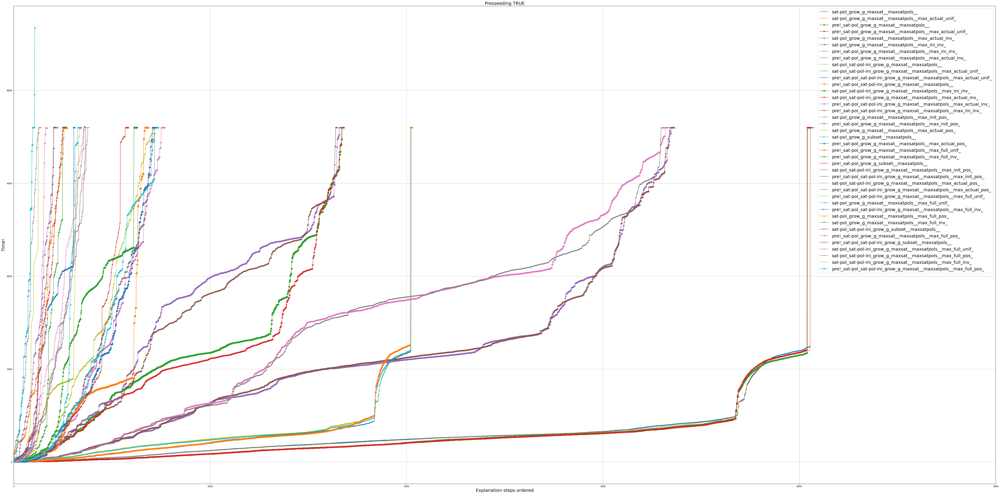

In [120]:
dfexp6cumulOUS = dfexp6[configKeys + resultsKeys]
dfexp6cumulOUSpreseedingTrue = dfexp6cumulOUS[(dfexp6cumulOUS["postpone_opt"] == False)]
groupByConfWithReduce(dfexp6cumulOUSpreseedingTrue, ["postpone_opt", "grow_maxsat_initial_unif"],"Presseeding TRUE")

In [83]:
# configs
configKeys = ['preseeding', 'sat-polarity', 'sat-polarity-initial', 'postpone_opt', 'postpone_opt_incr', 'postpone_opt_greedy', 'grow', 'grow_sat', 'grow_subset_maximal', 'grow_maxsat', 'maxsat_polarities', 'grow_maxsat_full_pos', 'grow_maxsat_full_inv', 'grow_maxsat_full_unif', 'grow_maxsat_initial_pos', 'grow_maxsat_initial_inv', 'grow_maxsat_initial_unif', 'grow_maxsat_actual_pos', 'grow_maxsat_actual_unif', 'grow_maxsat_actual_inv']
resultsKeys = ['cumul-ous']

# rsults
dfcumulOUS = dfexp4[configKeys + resultsKeys]
# display(dfcumulOUS)

In [133]:
def groupByConfWithReduce(df, selectedConfigFilters, title, fact='cumul-ous'):
    allconfigKeys = ['preseeding', 'sat-polarity', 'sat-polarity-initial', 'postpone_opt', 'postpone_opt_incr', 'postpone_opt_greedy', 'grow', 'grow_sat', 'grow_subset_maximal', 'grow_maxsat', 'maxsat_polarities', 'grow_maxsat_full_pos', 'grow_maxsat_full_inv', 'grow_maxsat_full_unif', 'grow_maxsat_initial_pos', 'grow_maxsat_initial_inv', 'grow_maxsat_initial_unif', 'grow_maxsat_actual_pos', 'grow_maxsat_actual_unif', 'grow_maxsat_actual_inv']
    groupKeys = [key for key in allconfigKeys if key not in selectedConfigFilters]
    dfgrouped = df.groupby(by=groupKeys)[fact].apply(list).reset_index(name=fact)
    # display(dfgrouped)
    dfgrouped[fact] = dfgrouped[fact] \
                                .apply(lambda x: sorted(reduce(lambda a,b: a + b, x))) \
                                .apply(lambda x: list(filter(lambda elem: elem > 0, x)))

    mapping = {
        'preseeding':'pre!',
        'sat-polarity': 'sat-pol',
        'sat-polarity-initial': 'sat-pol-ini',
        'postpone_opt': 'post',
        'postpone_opt_incr': 'p_incr',
        'postpone_opt_greedy': 'p_greedy',
        'grow': 'grow',
        'grow_sat': 'g_sat',
        'grow_subset_maximal': 'g_subset',
        'grow_maxsat': 'g_maxsat',
        'maxsat_polarities': '_maxsatpols_',
        'grow_maxsat_full_pos': 'max_full_pos',
        'grow_maxsat_full_inv': 'max_full_inv',
        'grow_maxsat_full_unif': 'max_full_unif',
        'grow_maxsat_initial_pos': 'max_init_pos',
        'grow_maxsat_initial_inv': 'max_ini_inv',
        'grow_maxsat_initial_unif': 'max_ini_pos',
        'grow_maxsat_actual_pos': 'max_actual_pos',
        'grow_maxsat_actual_unif': 'max_actual_unif',
        'grow_maxsat_actual_inv': 'max_actual_inv',
    }
    dfgrouped['config'] = dfgrouped.apply(
        lambda x: reduce(lambda a, b: a + (mapping[b]+'_' if x[b] else ''), [field for field in groupKeys if field not in [fact] and x[field]] , ""),
        axis = 1
    )
    dfgrouped['x'] = dfgrouped.apply(lambda x: list(range(len(x[fact])) ), axis=1 )
    dfgrouped['len'] = dfgrouped.apply(lambda x: len(x[fact]), axis=1 )
    for (i, row) in dfgrouped.sort_values(by ='len', ascending=False).iterrows():
        print(row)
    dfgrouped.sort_values(by ='len', ascending=False)
    # display(dfgrouped[['x','cumul-ous']])
    mStyles = [".",",","o","v","^","<",">","1","2","3","4","8","s","p","P","*","h","H","+","x","X","D","d","|","_",0,1,2,3,4,5,6,7,8,9,10,11]
    mStyles = mStyles * 10
    plt.figure(figsize=(80,40))
    for ((i, row), marker) in zip(dfgrouped.sort_values(by ='len', ascending=False).iterrows(), mStyles):
        plt.plot(row['x'], row[fact], label=row['config'], marker=marker )
    plt.legend(fontsize=20)
    plt.xlabel('Explanation steps ordered', fontsize=20)
    plt.xlim((0, 5000))
    plt.ylabel('Time!', fontsize=20)
    plt.title(title, fontsize=20)
    plt.grid(True)
    plt.savefig('/home/crunchmonster/Desktop/figs/experiment4'+ datetime.now().strftime("%Y%m%d%H%M%S%f.pdf"), optimize=True, bbox_inches='tight')
    dfgrouped.to_json('/home/crunchmonster/Desktop/json/experiment4'+ '_' + title+ '_'+ datetime.now().strftime("%Y%m%d%H%M%S%f.json"))
    dfgrouped.to_csv('/home/crunchmonster/Desktop/json/experiment4'+ '_' + title+ '_'+ datetime.now().strftime("%Y%m%d%H%M%S%f.csv"))
    plt.show()



se
grow_maxsat                                                             True
maxsat_polarities                                                       True
grow_maxsat_full_pos                                                    True
grow_maxsat_full_inv                                                   False
grow_maxsat_full_unif                                                  False
grow_maxsat_initial_pos                                                False
grow_maxsat_initial_inv                                                False
grow_maxsat_actual_pos                                                 False
grow_maxsat_actual_unif                                                False
grow_maxsat_actual_inv                                                 False
cumul-ous                  [52.605934858322144, 54.86047339439392, 55.157...
config                      sat-pol_grow_g_maxsat__maxsatpols__max_full_pos_
x                          [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,

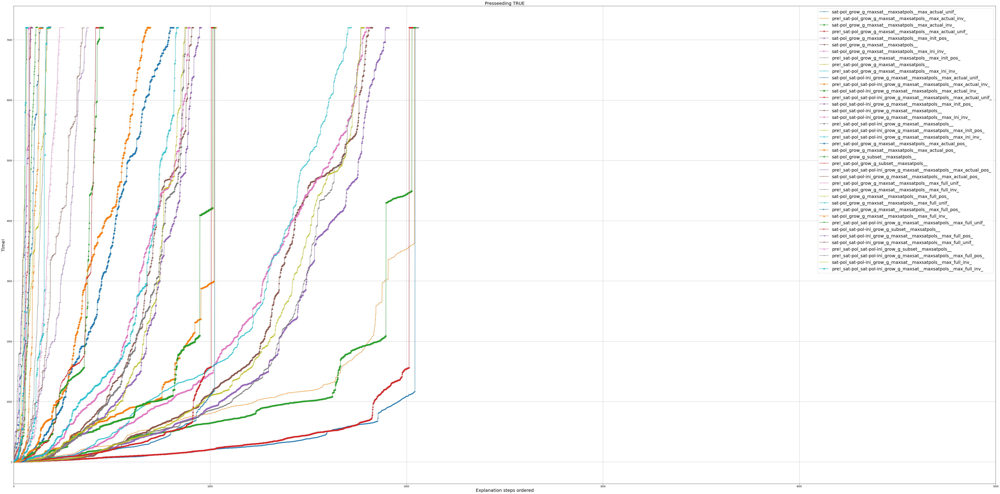

In [134]:

preseedingTrue = dfcumulOUS[(dfcumulOUS["postpone_opt"] == False)]
dfcumulSAT = dfexp4[configKeys + ["cumul-sat"]]


preseedingFalse = dfcumulOUS[(dfcumulOUS["postpone_opt"] == False) & (dfcumulOUS["grow_maxsat_initial_unif"] == True)]

groupByConfWithReduce(preseedingTrue, ["postpone_opt", "grow_maxsat_initial_unif"],"Presseeding TRUE")
# groupByConfWithReduce(dfcumulSAT[(dfcumulOUS["postpone_opt"] == False)], ["postpone_opt"],"Presseeding TRUE", "cumul-sat")
# groupByConfWithReduce(preseedingFalse, ["postpone_opt", 'grow_maxsat_initial_unif'], "preseeding FALSE")

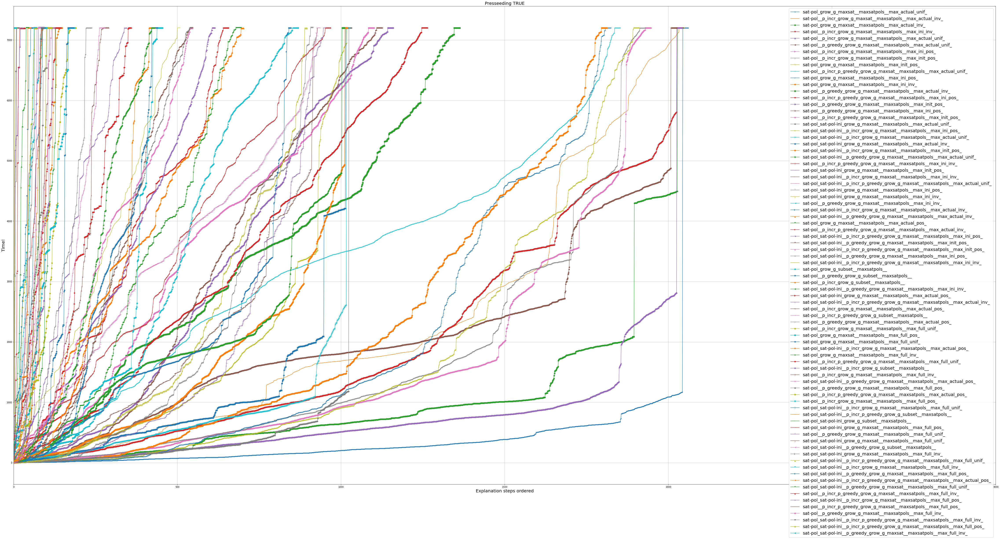

In [113]:
preseedingTrue = dfcumulOUS[(dfcumulOUS["preseeding"] == False)]
groupByConfWithReduce(preseedingTrue, ["preseeding"],"Presseeding TRUE")

In [13]:
selectedCols = ['timedout', 'config', 'totTime', 'timeToFirst', 'First-Tot', 'preseeding', 'sat-polarity', 'sat-polarity-initial', 'postpone_opt', 'postpone_opt_incr', 'postpone_opt_greedy', 'grow', 'grow_sat', 'grow_subset_maximal', 'grow_maxsat', 'maxsat_polarities', 'grow_maxsat_full_pos', 'grow_maxsat_full_inv', 'grow_maxsat_full_unif', 'grow_maxsat_initial_pos', 'grow_maxsat_initial_inv', 'grow_maxsat_initial_unif', 'grow_maxsat_actual_pos', 'grow_maxsat_actual_unif', 'grow_maxsat_actual_inv', 'instance', '#expl']
df4selectedCols = dfjsonexp4[selectedCols]
notPostCols = [k for k in selectedCols if k not in ['postpone_opt', 'postpone_opt_incr', 'postpone_opt_greedy']]

# RQ1 : Does preseeding help with anything at all ? 
# --- Is the time to First soltuion AND the total time reduced thx to preseeding ? 
df4NoPost = df4selectedCols[
    (df4selectedCols["postpone_opt"] == False)
    # (df4selectedCols["sat-polarity"] == False) & 
    # (df4selectedCols["sat-polarity-initial"] == False)
    ][notPostCols]

display(df4NoPost)



df4NoPostMaxSat = df4NoPost[df4NoPost["grow_maxsat"] == True][[k for k in notPostCols if k not in ['sat-polarity', 'sat-polarity-initial', 'grow_sat', 'grow_subset_maximal']]]

# Timedout



,timedout,config,totTime,timeToFirst,First-Tot,preseeding,sat-polarity,sat-polarity-initial,grow,grow_sat,...,grow_maxsat_full_inv,grow_maxsat_full_unif,grow_maxsat_initial_pos,grow_maxsat_initial_inv,grow_maxsat_initial_unif,grow_maxsat_actual_pos,grow_maxsat_actual_unif,grow_maxsat_actual_inv,instance,#expl
0,False,p25_pre_satpol_maxsat_polarities_MaxSat-Icur-unif,7200,6.160597,6.16 - [112],True,True,False,True,False,...,False,False,False,False,False,False,True,False,p25,112
2,True,puzzle_satpol_maxsat_polarities_MaxSat-A-pos,7200,247.425522,247.43 - [13],False,True,False,True,False,...,False,False,False,False,False,False,False,False,origin-problem,13
10,True,p25_pre_satpol_maxsat_polarities_MaxSat-A-unif,7200,18.311375,18.31 - [2],True,True,False,True,False,...,False,True,False,False,False,False,False,False,p25,2
15,False,p25_pre_satpol_satpol-ini_maxsat_polarities_Ma...,7200,0.006578,0.01 - [114],True,True,True,True,False,...,False,False,True,False,False,False,False,False,p25,114
30,True,pastaPuzzle_pre_satpol_maxsat_polarities_MaxSa...,7200,2006.990628,2006.99 - [1],True,True,False,True,False,...,False,False,False,False,False,False,False,False,pastaPuzzle,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2148,False,p18_satpol_maxsat_polarities_MaxSat-I0-inv,7200,10.277265,10.28 - [109],False,True,False,True,False,...,False,False,False,True,False,False,False,False,p18,109
2149,False,p93_satpol_maxsat_polarities_MaxSat-Icur-inv,7200,34.849016,34.85 - [113],False,True,False,True,False,...,False,False,False,False,False,False,False,True,p93,113
2152,True,p16_satpol_satpol-ini_maxsat_polarities_MaxSat...,7200,9.706437,9.71 - [35],False,True,True,True,False,...,False,False,False,False,False,True,False,False,p16,35
2156,False,p13_satpol_satpol-ini_maxsat_polarities_MaxSat...,7200,18.529254,18.53 - [116],False,True,True,True,False,...,False,False,False,False,False,False,False,True,p13,116


In [ ]:
def cactusPlot(x, y):
    

# Experiment 5

Analyzing the qualitative improvement over the explanation sequence.

**Fixed:**
- Optimal explanation sequence generated and fixed.
- For every optimal explanation step, compute the explanation with MUS.
- Plot the difference 

In [30]:
def extractCosts(jsonfiles):
    costs = {}
    for f in jsonfiles:
        instance = f['config']['instance']
        costs[instance] = []
        for expl in f['results']['expl_seq']:
            costs[instance].append(expl['cost'])
        
    return costs

In [31]:
def plotCosts(ousCosts, musCosts):
    plt.figure(figsize=(10,10))
 
    sizes = []
    x = []
    y = []
    for k in ousCosts:
        # minlen = min(len(ousCosts[k]), len(musCosts[k]))
        x1 = ousCosts[k]
        y1 = musCosts[k]
        x+= x1
        y += y1
    
    d = {}
    coeff_thick = 8
    for xi,yi in zip(x, y):
        if (xi, yi) in d:
            d[(xi, yi)] += coeff_thick
        else:
            d[(xi, yi)] = coeff_thick

    xplot = [] 
    yplot = []
    splot = []  
    for ((xi, yi), si) in d.items():
        xplot.append(xi)
        yplot.append(yi)
        splot.append(si)
    plt.scatter(xplot, yplot, s=splot)
#         # allCosts.append((x1, y1))
    # Plot formatting
    plt.plot(range(0, 400, 1) , range(0, 400, 1), linestyle='--')
    plt.legend(fontsize=20)
    # plt.xlim((0, 50))
    plt.xlabel('OUS Explanation cost', fontsize=20)
    plt.ylabel('MUS Explanation cost', fontsize=20)
#     plt.title(instance + " - " + col)
    plt.title("Comparison OUS/MUS Explanation cost", fontsize=20)
    plt.savefig('/home/crunchmonster/Desktop/figs/experiemnt5_qualitative_'+ datetime.now().strftime("%Y%m%d%H%M%S%f.jpg"), optimize=True, bbox_inches='tight')
    plt.show()


No handles with labels found to put in legend.


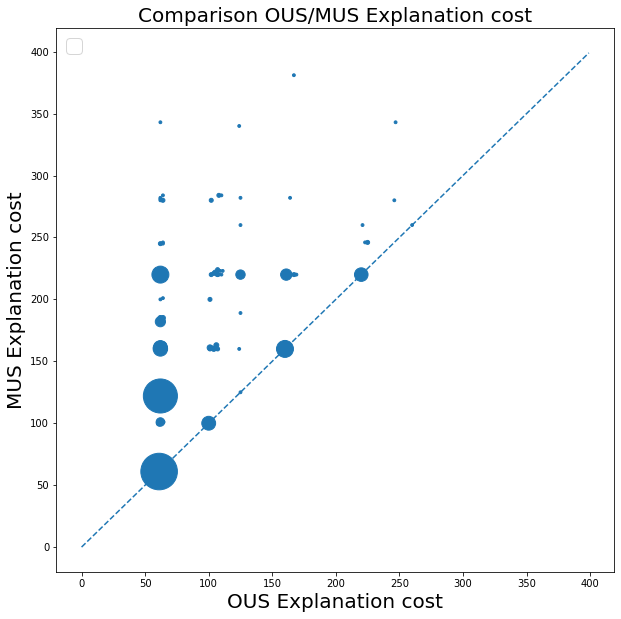

In [32]:
# processing the results
folder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment5_qualitative/2021011617/'
files = list_json_dir(folder)
json_files = [read_json(f) for f in files]
mus_json_files = [f for f in json_files if 'MUS-time' in f['results'].keys()]
ous_json_files = [f for f in json_files if f not in mus_json_files]
musCosts = extractCosts(mus_json_files)
ousCosts = extractCosts(ous_json_files)

plotCosts(ousCosts, musCosts)

# Experiment6

For every puzzle get the explanation sequence fastest result

folder = 

In [6]:
def musTimes(jsonMUS, instances):
    results = {k: 7200 for k in instances}
    for musTime in jsonMUS:
        results[musTime['config']['instance']] = round(sum(musTime['results']['MUS-time']))
    return results

In [43]:
def jsonToBest(jsonFiles, instances):
    results = {k: 7200 for k in instances}
    configs = {k:'' for k in instances}
    for f in jsonFiles:
        instance = f['config']['instance']
        totTime =  f["config"]["timeout"] if f['results']["timeout"] else sum(f['results']["OUS-time"]) 
        if instance not in results or totTime < results[instance] :
            results[instance] = round(totTime)
            configs[instance] = f['config']
    return results, configs



In [44]:
def greedyJsonToBest(jsonFiles, instances):
    resultsIncr = {k: 7200 for k in instances}
    resultsNonIncr = {k: 7200 for k in instances}
    litsToDerive = {k:0 for k in instances}
    for f in jsonFiles:
        if f['results']['timeout'] == True:
            continue

        if f['config']['reuse_SSes']:
            instance = f['config']['instance']
            litsDerived = sum(len(expl["derived"]) for expl in f['results']['expl_seq'])
            litsToDerive[instance] = max(litsDerived, litsToDerive[instance])
    for f in jsonFiles:
        if f['results']['timeout'] == True:
            continue
        instance = f['config']['instance']

        totTime = f['results']['totTime'] if 'totTime' in f['results'] else sum(sum(subl) for subl in f['results']["OUS-time"])
        if f['config']['reuse_SSes']:
            if instance not in resultsIncr or totTime <= resultsIncr[instance]:
                resultsIncr[instance] = round(totTime)
        else:
            litsderived = sum(len(expl["derived"]) for expl in f['results']['expl_seq']) if f['results']['#expl'] > 0 else 0
            if instance not in resultsNonIncr or totTime <= resultsNonIncr[instance]:
                resultsNonIncr[instance] = round(totTime)

    return resultsIncr, resultsNonIncr

In [45]:
def fillDictResults(dictResults, results, Name):
    for k,v in results.items():
        pos = dictResults['puzzles'].index(k)
        dictResults[Name][pos] = v

In [60]:
# MUS

musFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment5/2021011809/'
instances = set(read_json(f)['config']['instance'] for f in list_json_dir(musFolder))
musFiles = [read_json(f) for f in list_json_dir(musFolder)]
musResults = musTimes(musFiles, instances)

# # cOUS
cOUSnonIncrFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117'
cOUSNonIncrFiles = [read_json(f) for f in list_json_dir(cOUSnonIncrFolder)]
cOUSNonIncrResults, cOUSNonIncrconfigs = jsonToBest(cOUSNonIncrFiles, instances)

cOUSIncrFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment4'
cOUSIncrFiles = [read_json(f) for f in list_json_dir(cOUSIncrFolder)]
cOUSIncrResults, cOUSIncrResultsconfigs = jsonToBest(cOUSIncrFiles, instances)
 
# # Greedy
greedyFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_greedy/20210117/'
greedyFiles = [read_json(f) for f in list_json_dir(greedyFolder) if f.stat().st_size > 5]
greedyIncrResults, greedyNonIncrResults = greedyJsonToBest(greedyFiles, instances)

colRenaming={
    'p20':6, 
    'p93':8, 
    'pastaPuzzle':'p', 
    'p16':2, 
    'p25':7, 
    'origin-problem':1, 
    'p18':4, 
    'p13':10, 
    'p12':3,
    'p19':5
}

# seperate in Incremental and non-incremental

dictResults = {
    'puzzles': [k for k in instances],
    'p': [colRenaming[k] for k in instances],
    'MUS-based': [0 for k in instances],
    'OUS non-incr': [0 for k in instances],
    'OUS incr': [0 for k in instances],
    'cOUS non-incr': [0 for  k in  instances],
    'cOUS + incr':[0 for k in instances]
}

fillDictResults(dictResults, musResults, 'MUS-based')
fillDictResults(dictResults, greedyNonIncrResults, 'OUS non-incr')
fillDictResults(dictResults, greedyIncrResults, 'OUS incr')
fillDictResults(dictResults, cOUSNonIncrResults, 'cOUS non-incr')
fillDictResults(dictResults, cOUSIncrResults, 'cOUS + incr')

dfExp6 = pd.DataFrame(dictResults)[['p', 'MUS-based', 'OUS non-incr', 'OUS incr', 'cOUS non-incr', 'cOUS + incr']]
display(dfExp6)

tx = dfExp6.to_latex(
    bold_rows=True,
    index=False, 
    column_format='|r||c|c|c|c|c|c|',
    caption="Execution time compared between executions")
print(tx.replace('\\toprule', '\hline')
      .replace('\midrule', '\hline')
      .replace('\\bottomrule', '\hline')
      .replace('{table}', '{table*}')
     )

,p,MUS-based,OUS non-incr,OUS incr,cOUS non-incr,cOUS + incr
0,6,568,3849,3854,371,146
1,2,438,3834,3972,565,238
2,5,3382,7200,7200,1977,1825
3,7,372,4682,4380,645,414
4,4,624,3508,4820,314,97
5,p,224,2601,2528,618,528
6,3,477,4220,4938,874,607
7,8,474,4679,5552,644,448
8,10,766,7200,7200,2308,1135
9,1,569,4114,4727,779,299


\begin{table*}
\centering
\caption{Execution time compared between executions}
\begin{tabular}{|r||c|c|c|c|c|c|}
\hline
  p &  MUS-based &  OUS non-incr &  OUS incr &  cOUS non-incr &  cOUS + incr \\
\hline
  6 &        568 &          3849 &      3854 &            371 &          146 \\
  2 &        438 &          3834 &      3972 &            565 &          238 \\
  5 &       3382 &          7200 &      7200 &           1977 &         1825 \\
  7 &        372 &          4682 &      4380 &            645 &          414 \\
  4 &        624 &          3508 &      4820 &            314 &           97 \\
  p &        224 &          2601 &      2528 &            618 &          528 \\
  3 &        477 &          4220 &      4938 &            874 &          607 \\
  8 &        474 &          4679 &      5552 &            644 &          448 \\
 10 &        766 &          7200 &      7200 &           2308 &         1135 \\
  1 &        569 &          4114 &      4727 &            779 &          

In [61]:
pd.DataFrame([v for k, v in cOUSIncrResultsconfigs.items()])

,preseeding,sat-polarity,sat-polarity-initial,postpone_opt,postpone_opt_incr,postpone_opt_greedy,grow,grow_sat,grow_subset_maximal,grow_maxsat,...,grow_maxsat_full_unif,grow_maxsat_initial_pos,grow_maxsat_initial_inv,grow_maxsat_initial_unif,grow_maxsat_actual_pos,grow_maxsat_actual_unif,grow_maxsat_actual_inv,timeout,instance,output
0,True,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p20,/data/brussel/101/vsc10143/OUSResults/experime...
1,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p16,/data/brussel/101/vsc10143/OUSResults/experime...
2,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p19,/data/brussel/101/vsc10143/OUSResults/experime...
3,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p25,/data/brussel/101/vsc10143/OUSResults/experime...
4,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p18,/data/brussel/101/vsc10143/OUSResults/experime...
5,True,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,pastaPuzzle,/data/brussel/101/vsc10143/OUSResults/experime...
6,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p12,/data/brussel/101/vsc10143/OUSResults/experime...
7,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p93,/data/brussel/101/vsc10143/OUSResults/experime...
8,False,True,False,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,p13,/data/brussel/101/vsc10143/OUSResults/experime...
9,False,True,True,False,False,False,True,False,False,True,...,False,False,False,False,False,True,False,7200,origin-problem,/data/brussel/101/vsc10143/OUSResults/experime...


In [55]:
cOUSnonIncrFolder = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117'
cOUSNonIncrFiles = [(f, read_json(f)) for f in list_json_dir(cOUSnonIncrFolder)]

for fp, f in cOUSNonIncrFiles:

    instance = f['config']['instance']
    if instance != 'p19':
        continue
    if f['results']["timeout"]:
        continue
    totTime =  f["config"]["timeout"] if f['results']["timeout"] else sum(f['results']["OUS-time"]) 
    if f['config']['preseeding']:
        print("preseeeding!!!!")
    print(fp, f["config"]["output"], totTime)

/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117/p19_20210118170636306268.json /data/brussel/101/vsc10143/OUSResults/experiment6_cous/2021011817/20210118170636306268.json 3754.5219271183014
/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117/p19_20210118170709886251.json /data/brussel/101/vsc10143/OUSResults/experiment6_cous/2021011817/20210118170709886251.json 5007.30952000618
preseeeding!!!!
/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117/p19_20210118170636306339.json /data/brussel/101/vsc10143/OUSResults/experiment6_cous/2021011817/20210118170636306339.json 2681.3171231746674
preseeeding!!!!
/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment6_cous/20210117/p19_20210118170636306473.json /data/brussel/101/vsc10143/OUSResults/experiment6_cous/2021011817/20210118170636306473.json 1977.0353798866272
preseeeding!!!!
/home/crunchmonster/Do

In [56]:
def bestPreseedingOffOn(jsonFiles, instances):
    bestPreseedingOff = {k: 7200 for k in instances}
    bestPreseedingOn = {k: 7200 for k in instances}
    for f in jsonFiles:
        instance = f['config']['instance']
        totTime =  f["config"]["timeout"] if f['results']["timeout"] else sum(f['results']["OUS-time"]) 
        preseeding = f['config']['preseeding']
        if preseeding:
            if instance not in bestPreseedingOn or totTime < bestPreseedingOn[instance] :
                bestPreseedingOn[instance] = round(totTime)
        else:
            if instance not in bestPreseedingOff or totTime < bestPreseedingOff[instance] :
                bestPreseedingOff[instance] = round(totTime)

    return bestPreseedingOff, bestPreseedingOn


In [57]:
cOUSIncrFolderExp6Bis = '/home/crunchmonster/Documents/VUB/01_SharedProjects/03_resultsOUS/experiment4'
cOUSIncrFilesExp6Bis = [read_json(f) for f in list_json_dir(cOUSIncrFolderExp6Bis)]
bestPreseedingOff, bestPreseedingOn = bestPreseedingOffOn(cOUSIncrFilesExp6Bis, instances)

In [58]:
print(bestPreseedingOff)

{'p20': 155, 'p16': 238, 'p19': 1825, 'p25': 414, 'p18': 97, 'pastaPuzzle': 651, 'p12': 607, 'p93': 448, 'p13': 1135, 'origin-problem': 299}


In [59]:
print(bestPreseedingOn)

{'p20': 146, 'p16': 250, 'p19': 2397, 'p25': 446, 'p18': 112, 'pastaPuzzle': 528, 'p12': 662, 'p93': 521, 'p13': 1359, 'origin-problem': 310}
